We're going to use image vectors both for EDA and for classification, so let's add some code that will get image vectors from ResNeXt.

In [1]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np


DEVICE = torch.device('cpu')
OUTPUT_SIZE = 2048

model = models.resnext50_32x4d(weights=models.ResNeXt50_32X4D_Weights.IMAGENET1K_V2)

extraction_layer = model._modules.get('avgpool')
model.to(DEVICE)
model.eval()

scaler = transforms.Resize((224, 224))
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
to_tensor = transforms.ToTensor()

def get_vec(arg, model, extraction_layer):
    image = normalize(to_tensor(scaler(arg))).unsqueeze(0).to(DEVICE)
    result = torch.zeros(1, OUTPUT_SIZE, 1, 1)
    def copy_data(m, i, o):
        result.copy_(o.data)
    hooked = extraction_layer.register_forward_hook(copy_data)
    with torch.no_grad():
        model(image)
    hooked.remove()
    return result

Downloading: "https://download.pytorch.org/models/resnext50_32x4d-1a0047aa.pth" to /root/.cache/torch/hub/checkpoints/resnext50_32x4d-1a0047aa.pth
100%|██████████| 95.8M/95.8M [00:00<00:00, 132MB/s]


Next let's load up our image vectors, thumbnails, and labels. We have at least one case where the label data is broken, so our label code assigns a bogus label that we then remove.

In [2]:
import arrow
import base64
import pandas as pd
from glob import iglob
from io import BytesIO
from os.path import basename
from PIL import Image

STOP = 2000
TEST = '/kaggle/input/sard-2-search-and-rescue-dataset-extra-classes/search-and-rescue-2/test/'
THUMBNAIL_SIZE = (64, 64)
TRAIN = '/kaggle/input/sard-2-search-and-rescue-dataset-extra-classes/search-and-rescue-2/train/'
VALID = '/kaggle/input/sard-2-search-and-rescue-dataset-extra-classes/search-and-rescue-2/valid/'


def embed(model, filename: str):
    with Image.open(fp=filename, mode='r') as image:
        return get_vec(arg=image.convert('RGB'), model=model, extraction_layer=extraction_layer).numpy().reshape(OUTPUT_SIZE,)


# https://stackoverflow.com/a/952952
def flatten(arg):
    return [x for xs in arg for x in xs]

def png(filename: str) -> str:
    with Image.open(fp=filename, mode='r') as image:
        buffer = BytesIO()
        # our images are pretty big; let's shrink the hover images to thumbnail size
        image.resize(size=THUMBNAIL_SIZE).convert('RGB').save(buffer, format='png')
        return 'data:image/png;base64,' + base64.b64encode(buffer.getvalue()).decode()

def label(filename: str) -> str:
    pieces = filename.split('.')
    filename = '.'.join(pieces[:-1]) + '.txt'
    pieces = filename.split('/')
    pieces = [piece if piece != 'images' else 'labels' for piece in pieces]
    filename = '/'.join(pieces)
    try:
        with open(file=filename, mode='r') as fp:
            return fp.readlines()[0].split(' ')[0]
    except:
        return -1
    

def get_picture_from_glob(arg: str, stop: int) -> list:
    time_get = arrow.now()
    result = [pd.Series(data=[basename(input_file), embed(model=model, filename=input_file), png(filename=input_file), label(filename=input_file)], 
                        index=['name', 'value', 'png', 'label'])
        for index, input_file in enumerate(iglob(pathname=arg)) if index < stop and input_file.endswith('.jpg')]
    print('encoded {} rows in {}'.format(len(result), arrow.now() - time_get))
    return result

time_start = arrow.now()
train_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TRAIN + '/*')}
train_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, stop=STOP) for key, value in train_dict.items()]))
valid_dict = {basename(folder) : folder + '/*.*' for folder in iglob(VALID + '/*')}
valid_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, stop=STOP) for key, value in valid_dict.items()]))
train_df = pd.concat(axis='index', objs=[train_df, valid_df])
train_df = train_df[train_df['label'] != -1]
test_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TEST + '/*')}
test_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, stop=STOP) for key, value in test_dict.items()]))
test_df = test_df[test_df['label'] != -1]
print('done in {}'.format(arrow.now() - time_start))

encoded 0 rows in 0:00:00.094170
encoded 1386 rows in 0:05:18.917747
encoded 0 rows in 0:00:00.100774
encoded 396 rows in 0:01:27.239555
encoded 0 rows in 0:00:00.062201
encoded 198 rows in 0:00:43.698597
done in 0:07:30.305277


Next we use TSNE to get x/y coordinates from our image vectors.

In [3]:
import arrow
from sklearn.manifold import TSNE

time_start = arrow.now()
train_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
train_df[['x', 'y']] = train_reducer.fit_transform(X=train_df['value'].apply(func=pd.Series))
print('done with TSNE in {}'.format(arrow.now() - time_start))

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1778 samples in 0.013s...
[t-SNE] Computed neighbors for 1778 samples in 0.421s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1778
[t-SNE] Computed conditional probabilities for sample 1778 / 1778
[t-SNE] Mean sigma: 4.541678
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.680374
[t-SNE] KL divergence after 1000 iterations: 0.350647
done with TSNE in 0:00:08.376345


Now we're ready to plot.

In [4]:
from bokeh.models import ColumnDataSource
from bokeh.models import HoverTool

from bokeh.plotting import figure
from bokeh.plotting import output_notebook
from bokeh.plotting import show
from bokeh.palettes import Turbo256
from bokeh.transform import factor_cmap

output_notebook()

datasource = ColumnDataSource(train_df[['png', 'label', 'x', 'y']])
factor_count = max(train_df['label'].nunique(), 3)
indices = np.linspace(0, len(Turbo256)-1, factor_count, dtype=int)
palette = [Turbo256[index] for index in indices]
mapper = factor_cmap(field_name = 'label', palette=palette, factors=train_df['label'].unique().tolist(), start=0, end=factor_count-1, )

plot_figure = figure(title='TSNE projection: search and rescue', width=1000, height=800, tools=('pan, wheel_zoom, reset'))

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@png' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 18px'>@label</span>
    </div>
</div>
"""))

plot_figure.scatter(x='x', y='y', source=datasource, line_alpha=0.6, fill_alpha=0.6, size=7, color=mapper)
show(plot_figure)

Loading BokehJS ...

What do we see? As is often the case with figure in scene data, the clusters that TSNE finds do not correspond in any way to the classes. Also it looks like our data has a lot of duplicate or near-duplicate images in it. This suggests that if we build a model the model accuracy may be misleading. Let's build a model and see what we get.

In [5]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split

logreg = LogisticRegression(max_iter=2000, tol=1e-12).fit(train_df['value'].apply(pd.Series), train_df['label'])
print('model fit in {} iterations'.format(logreg.n_iter_[0]))
print('accuracy: {:5.4f}'.format(accuracy_score(y_true=test_df['label'], y_pred=logreg.predict(X=test_df['value'].apply(pd.Series)))))
print('f1: {:5.4f}'.format(f1_score(average='weighted', y_true=test_df['label'], y_pred=logreg.predict(X=test_df['value'].apply(pd.Series)))))
print(classification_report(y_true=test_df['label'], y_pred=logreg.predict(X=test_df['value'].apply(pd.Series)), zero_division=0))

model fit in 1456 iterations
accuracy: 0.7929
f1: 0.7897
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       0.75      0.73      0.74        33
           2       0.84      0.90      0.87        52
           3       0.71      0.71      0.71        31
           4       0.82      0.85      0.84        39
           5       0.79      0.74      0.77        42

    accuracy                           0.79       198
   macro avg       0.65      0.65      0.65       198
weighted avg       0.79      0.79      0.79       198



Our model is not especially accurate for a number of reasons. Let's see what our model probabilities look like. We need to introduce a new reducer just for the test data, because we can't reuse the one we trained on the training data.

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 198 samples in 0.002s...
[t-SNE] Computed neighbors for 198 samples in 0.014s...
[t-SNE] Computed conditional probabilities for sample 198 / 198
[t-SNE] Mean sigma: 6.552272
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.353981
[t-SNE] KL divergence after 1000 iterations: 0.211614


<Axes: xlabel='x', ylabel='y'>

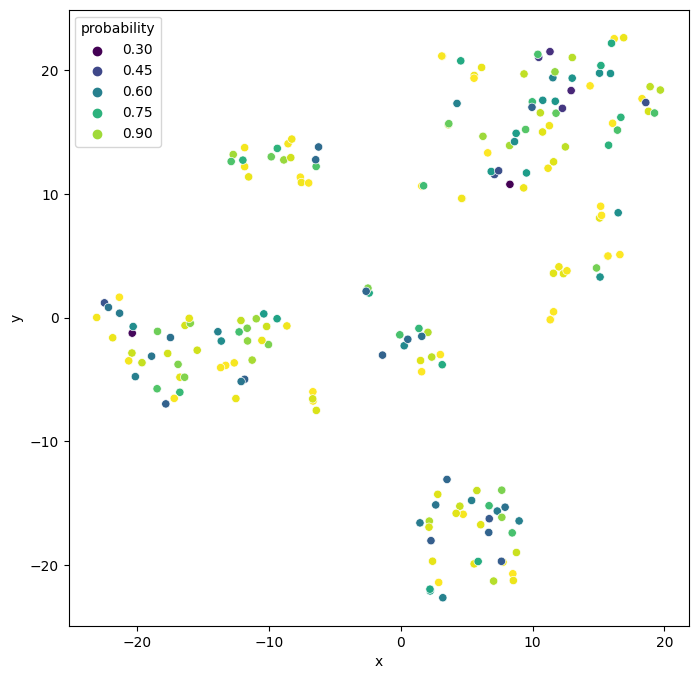

In [6]:
import matplotlib.pyplot as plt
from seaborn import scatterplot

test_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
test_df[['x', 'y']] = test_reducer.fit_transform(X=test_df['value'].apply(func=pd.Series))

fig, ax = plt.subplots(figsize=(8, 8))
plot_df = test_df[['x', 'y']].copy()
plot_df['probability'] = np.max(logreg.predict_proba(X=test_df['value'].apply(func=pd.Series)), axis=1)
scatterplot(ax=ax, data=plot_df, x='x', y='y', hue='probability', palette='viridis')

Not surprisingly our high model probabilities are concentrated in our duplicate and near-duplicate images.